# DS701 Predictive Model Based on Homelessness

#### Import Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
import plotly.express as px

#### Load the Dataset

In [2]:
df = pd.read_csv('final_homeless_dataset.csv')

#### Dataset Overview

In [3]:
# The shape of the dataset
print("Shape of the dataset:", df.shape)

Shape of the dataset: (32580, 7)


In [4]:
# The first few rows of the dataset
print("\nFirst 5 rows of the dataset:")
df.head()


First 5 rows of the dataset:


,CoC Number,CoC Name,CoC Category,Count Types,Homelessness.Type,Count,Year
0,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Overall.Homeless,974,2007
1,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Sheltered.Total.Homeless,842,2007
2,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Unsheltered.Homeless,132,2007
3,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Overall.Homeless.Individuals,696,2007
4,AK-500,Anchorage CoC,Other Largely Urban CoC,NaN,Overall.Homeless.People.in.Families,278,2007


In [5]:
# Information about the dataset
print("Dataset Info:")
df.info()

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32580 entries, 0 to 32579
Data columns (total 7 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   CoC Number         32580 non-null  object
 1   CoC Name           32580 non-null  object
 2   CoC Category       32225 non-null  object
 3   Count Types        28690 non-null  object
 4   Homelessness.Type  32580 non-null  object
 5   Count              32580 non-null  int64 
 6   Year               32580 non-null  int64 
dtypes: int64(2), object(5)
memory usage: 1.7+ MB


In [6]:
# Statistics Summary for numerical columns
print("\nStatistics Summary for numerical columns:")
df.describe()


Statistics Summary for numerical columns:


,Count,Year
count,32580.000000,32580.000000
mean,915.941743,2015.017035
std,3074.675315,4.903018
min,0.000000,2007.000000
25%,140.000000,2011.000000
50%,341.000000,2015.000000
75%,842.000000,2019.000000
max,88025.000000,2023.000000


#### Check for Null Values

In [7]:
print("\nMissing values in the dataset:")
print(df.isnull().sum())


Missing values in the dataset:
CoC Number              0
CoC Name                0
CoC Category          355
Count Types          3890
Homelessness.Type       0
Count                   0
Year                    0
dtype: int64


#### Check for Duplicates

In [8]:
print("\nNumber of duplicate rows:", df.duplicated().sum())


Number of duplicate rows: 0


#### Check for Count Type Distribution

In [9]:
df['Count Types'].value_counts()

Count Types
Sheltered and Unsheltered Count            24895
Sheltered-Only Count                        2885
No 2010 PIT Count                            425
Sheltered and Partial Unsheltered Count      375
Sheltered-Only Count*                        110
Name: count, dtype: int64

#### Check for CoC Category Distribution

In [10]:
df['CoC Category'].value_counts()

CoC Category
Largely Suburban CoC       14065
Largely Rural CoC           9130
Other Largely Urban CoC     4865
Major City CoC              4165
Name: count, dtype: int64

#### Check Data Range of Numerical Columns

In [11]:
print("\nData ranges for numerical columns:")
for col in df.select_dtypes(include=['float64', 'int64']).columns:
    print(f"{col}: Min = {df[col].min()}, Max = {df[col].max()}")


Data ranges for numerical columns:
Count: Min = 0, Max = 88025
Year: Min = 2007, Max = 2023


#### Check Unique Values in Categorical Columns

In [12]:
categorical_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()

print("\nUnique values in each categorical column:")
for col in categorical_columns:
    print(f"\nColumn: {col}")
    print(df[col].unique())


Unique values in each categorical column:

Column: CoC Number
['AK-500' 'AK-501' 'AL-500' 'AL-501' 'AL-502' 'AL-503' 'AL-504' 'AL-505'
 'AL-506' 'AL-507' 'AR-500' 'AR-501' 'AR-502' 'AR-504' 'AR-505' 'AR-506'
 'AR-508' 'AR-509' 'AR-510' 'AZ-500' 'AZ-501' 'AZ-502' 'CA-500' 'CA-501'
 'CA-502' 'CA-503' 'CA-504' 'CA-505' 'CA-506' 'CA-507' 'CA-508' 'CA-509'
 'CA-510' 'CA-511' 'CA-512' 'CA-513' 'CA-514' 'CA-515' 'CA-516' 'CA-517'
 'CA-518' 'CA-519' 'CA-520' 'CA-521' 'CA-522' 'CA-523' 'CA-524' 'CA-525'
 'CA-526' 'CA-600' 'CA-601' 'CA-602' 'CA-603' 'CA-604' 'CA-606' 'CA-607'
 'CA-608' 'CA-609' 'CA-611' 'CA-612' 'CA-613' 'CA-614' 'CO-500' 'CO-503'
 'CO-504' 'CT-503' 'CT-505' 'DC-500' 'DE-500' 'FL-500' 'FL-501' 'FL-502'
 'FL-503' 'FL-504' 'FL-505' 'FL-506' 'FL-507' 'FL-508' 'FL-509' 'FL-510'
 'FL-511' 'FL-512' 'FL-513' 'FL-514' 'FL-515' 'FL-517' 'FL-518' 'FL-519'
 'FL-520' 'FL-600' 'FL-601' 'FL-602' 'FL-603' 'FL-604' 'FL-605' 'FL-606'
 'GA-500' 'GA-501' 'GA-503' 'GA-504' 'GA-505' 'GA-506' 'GA-50

## Data Visualization 

### 1. Line Plot: Overall Homelessness Count over Years

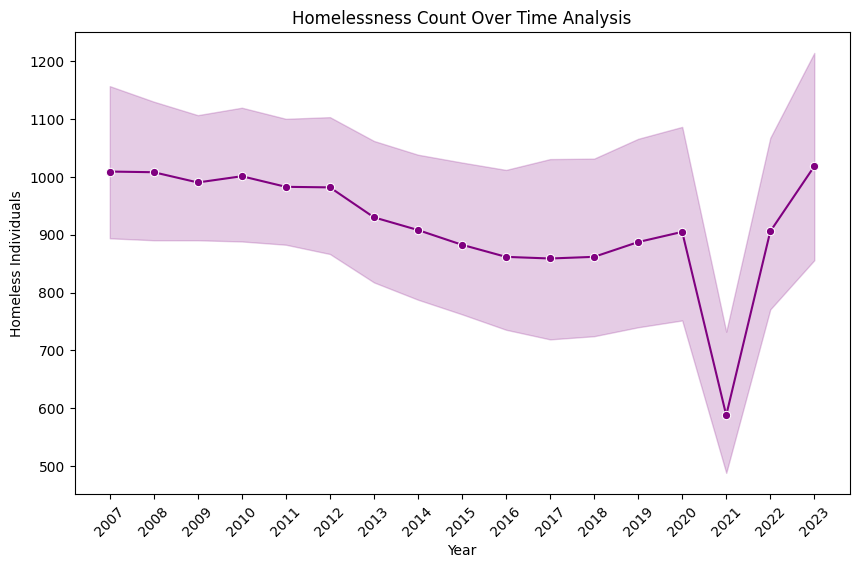

In [13]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=df, x='Year', y='Count', marker='o', color='purple')
plt.title('Homelessness Count Over Time Analysis')
plt.xlabel('Year')
plt.ylabel('Homeless Individuals')
plt.xticks(df['Year'].unique(), rotation=45)
plt.show()

### 2. Grouped Bar Plot: Overall Homeless vs Sheltered/Unsheltered by Year

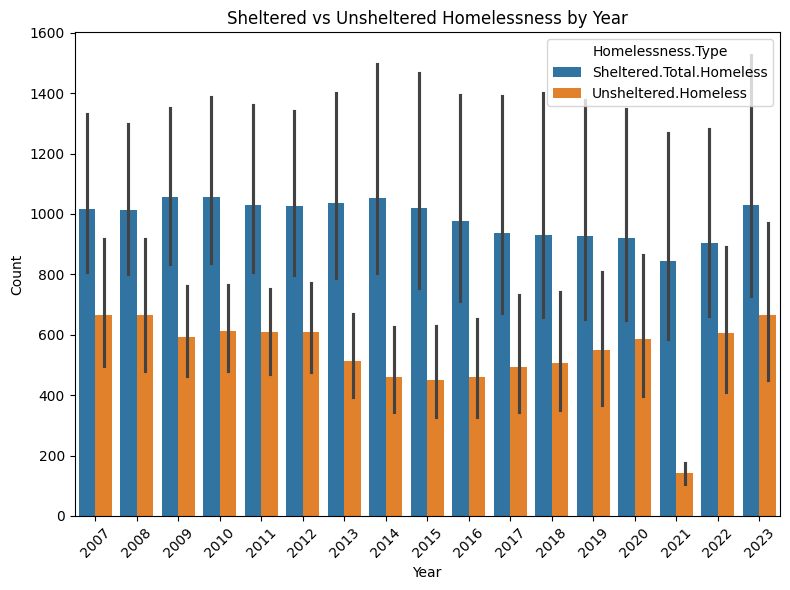

In [14]:
plt.figure(figsize=(8, 6))
sns.barplot(x='Year', y='Count', hue='Homelessness.Type', 
            data=df[df['Homelessness.Type'].isin(['Sheltered.Total.Homeless', 'Unsheltered.Homeless'])])
plt.title('Sheltered vs Unsheltered Homelessness by Year')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### 3. Scatter Plot: Count of Homeless People in Families vs Individuals

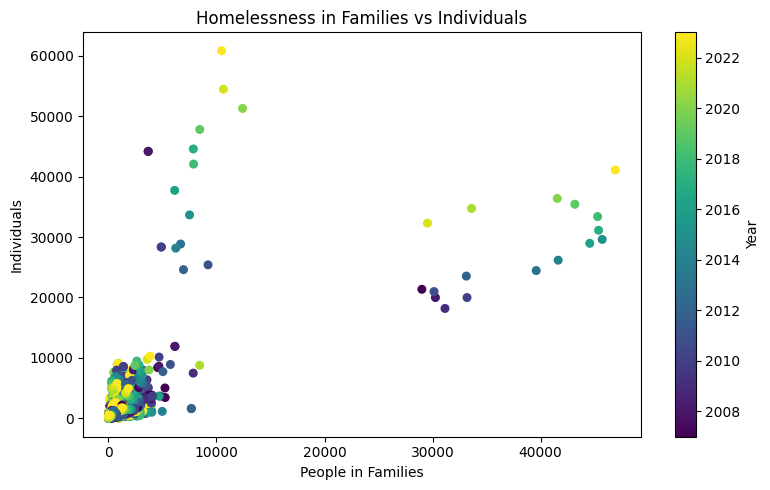

In [15]:
df_family_individuals = df[df['Homelessness.Type'].isin(['Overall.Homeless.People.in.Families', 'Overall.Homeless.Individuals'])]
pivot_fi = df_family_individuals.pivot(index=['CoC Number', 'Year'], columns='Homelessness.Type', values='Count').dropna()
plt.figure(figsize=(8, 5))
plt.scatter(pivot_fi['Overall.Homeless.People.in.Families'], pivot_fi['Overall.Homeless.Individuals'], 
            c=pivot_fi.index.get_level_values('Year'), cmap='viridis', s=30)
plt.colorbar(label='Year')
plt.title('Homelessness in Families vs Individuals')
plt.xlabel('People in Families')
plt.ylabel('Individuals')
plt.tight_layout()
plt.show()

### 4. Pie Chart: Comparison of Homelessness Types and Category Distribution

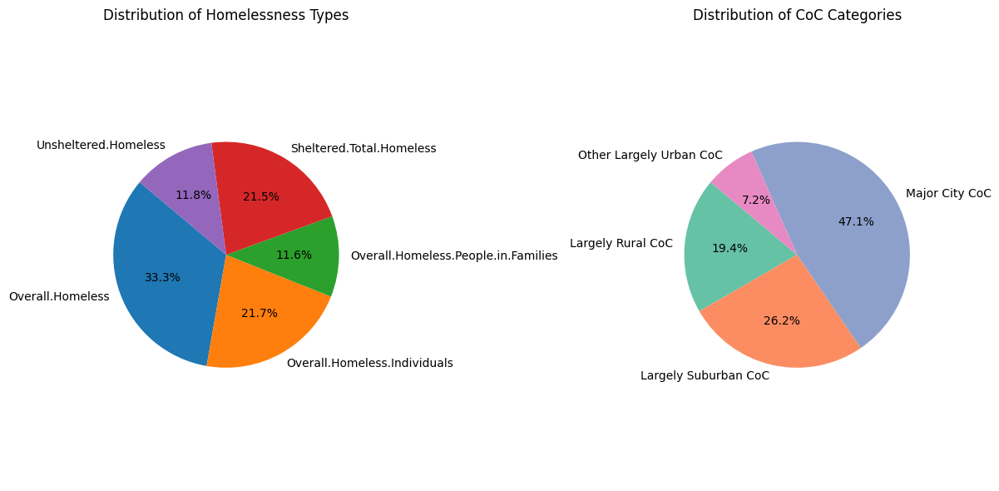

In [16]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6)) 

# First Pie Chart: Distribution of Homelessness Types
homelessness_counts = df.groupby('Homelessness.Type')['Count'].sum()
axes[0].pie(homelessness_counts, labels=homelessness_counts.index, autopct='%1.1f%%', startangle=140)
axes[0].set_title('Distribution of Homelessness Types')
axes[0].axis('equal') 

# Second Pie Chart: Distribution of CoC Categories
df_category = df[df['Homelessness.Type'] == 'Overall.Homeless'].groupby('CoC Category')['Count'].sum()
axes[1].pie(df_category, labels=df_category.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('Set2'))
axes[1].set_title('Distribution of CoC Categories')
axes[1].axis('equal')

plt.tight_layout()
plt.show()

### 5. Heatmap: Correlation between Count and Year

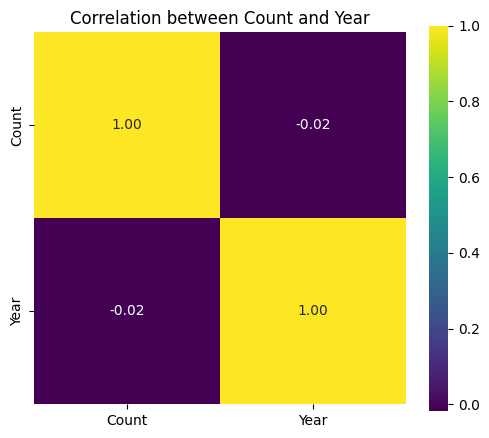

In [17]:
plt.figure(figsize=(6, 5))
correlation = df.select_dtypes(include=['int64', 'float64']).corr()
sns.heatmap(correlation, annot=True, fmt=".2f", cmap='viridis', square=True)
plt.title('Correlation between Count and Year')
plt.show()

### 6. Scatter Plot: Trends in Homelessness Count by Year and Type

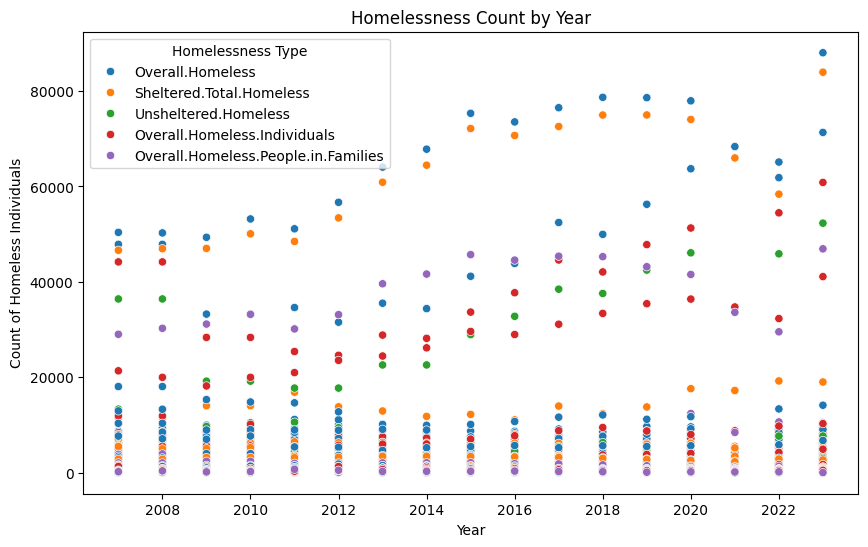

In [18]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Year', y='Count', hue='Homelessness.Type', data=df)
plt.title('Homelessness Count by Year')
plt.xlabel('Year')
plt.ylabel('Count of Homeless Individuals')
plt.legend(title='Homelessness Type')
plt.show()

### 7. Line Plot: Homeless Count by Category Over Years

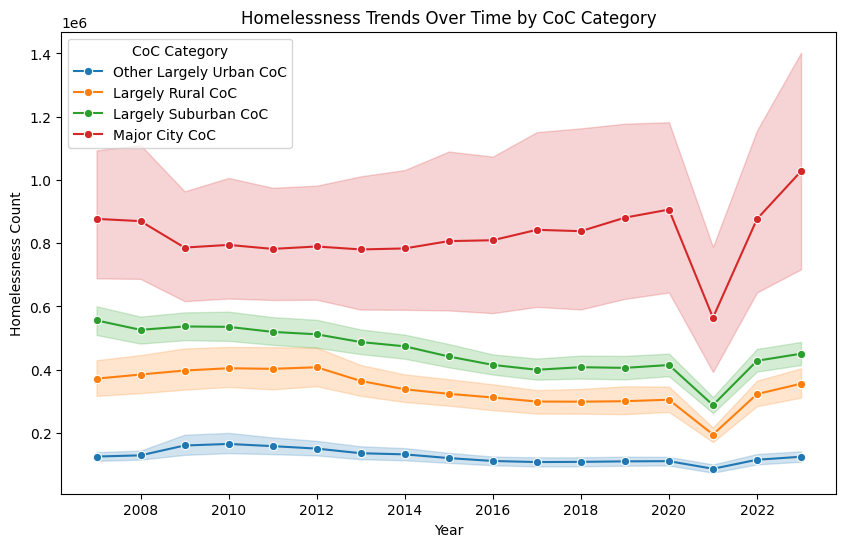

In [19]:
plt.figure(figsize=(10, 6))
sns.lineplot(data=df, x='Year', y='Count', hue='CoC Category',estimator='sum', marker="o")
plt.title('Homelessness Trends Over Time by CoC Category')
plt.xlabel('Year')
plt.ylabel('Homelessness Count')
plt.legend(title='CoC Category')
plt.show()

### 8. Grouped Bar Plot: Total Homelessness Count by Category

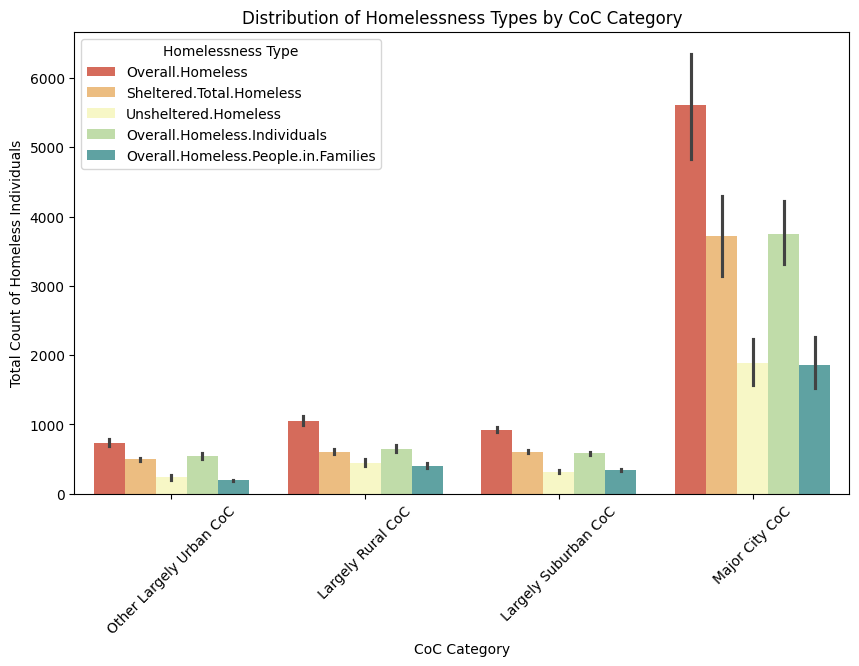

In [20]:
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x='CoC Category', y='Count', hue='Homelessness.Type', palette='Spectral')
plt.title('Distribution of Homelessness Types by CoC Category')
plt.xlabel('CoC Category')
plt.ylabel('Total Count of Homeless Individuals')
plt.xticks(rotation=45)
plt.legend(title='Homelessness Type')
plt.xticks(rotation=45)
plt.show()

### 9. Box Plot: Distribution of Counts by Homelessness Type

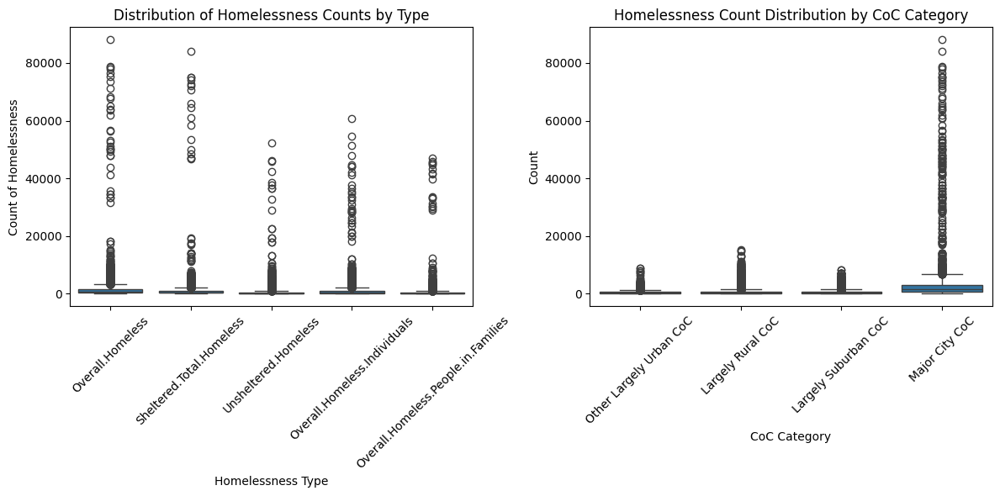

In [21]:
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# First boxplot: Homelessness Type vs Count
sns.boxplot(data=df, x='Homelessness.Type', y='Count', ax=axes[0])
axes[0].set_title('Distribution of Homelessness Counts by Type')
axes[0].set_xlabel('Homelessness Type')
axes[0].set_ylabel('Count of Homelessness')
axes[0].tick_params(axis='x', rotation=45)

# Second boxplot: CoC Category vs Count for Overall Homeless
sns.boxplot(data=df, x='CoC Category', y='Count', ax=axes[1])
axes[1].set_title('Homelessness Count Distribution by CoC Category')
axes[1].set_xlabel('CoC Category')
axes[1].set_ylabel('Count')
axes[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

### 10. HeatMap: Homelessness Distribution Across Top 10 CoCs Over Time

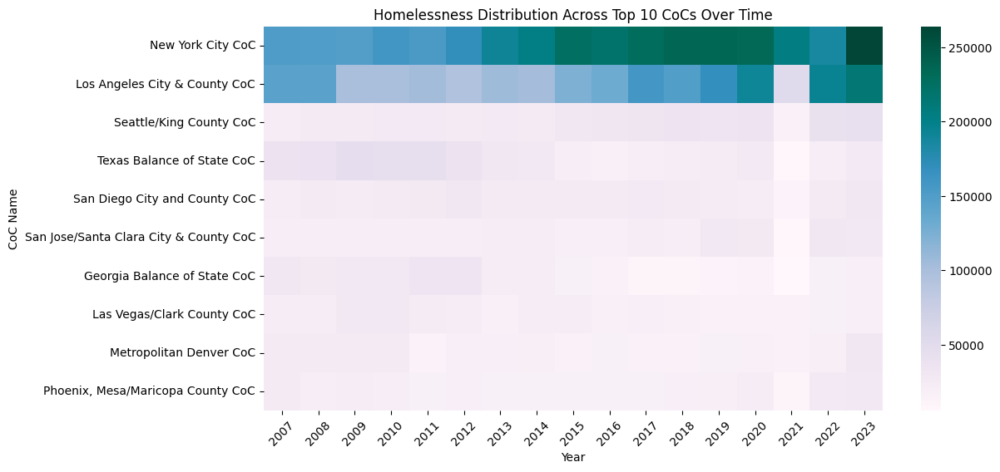

In [22]:
coc_total_counts = df.groupby('CoC Name')['Count'].sum().reset_index()
top_10_cocs = coc_total_counts.nlargest(10, 'Count')['CoC Name']
df_top_10 = df[df['CoC Name'].isin(top_10_cocs)]
pivot_table = df_top_10.pivot_table(values='Count', index='CoC Name', columns='Year', aggfunc='sum', fill_value=0)
pivot_table = pivot_table.loc[pivot_table.sum(axis=1).sort_values(ascending=False).index]
plt.figure(figsize=(12, 6))
sns.heatmap(pivot_table, cmap='PuBuGn')
plt.title('Homelessness Distribution Across Top 10 CoCs Over Time')
plt.xlabel('Year')
plt.ylabel('CoC Name')
plt.xticks(rotation=45)
plt.show()

### 11. Bubble Map: Homelessness Count in CoCs

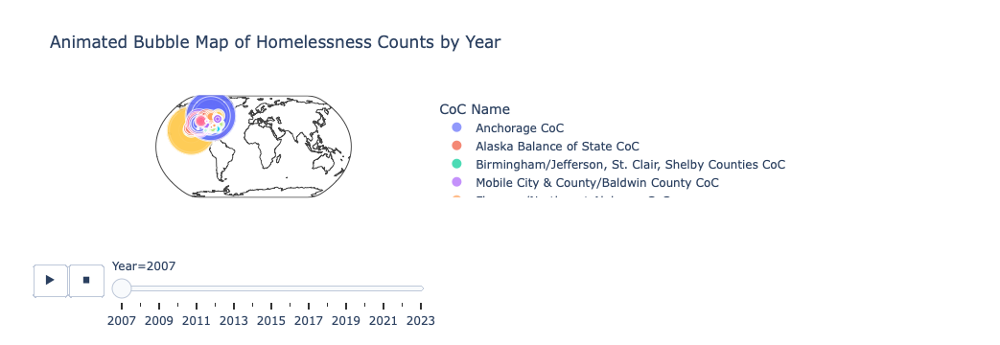

In [23]:
np.random.seed(42)  
unique_names = df['CoC Name'].unique()
coordinates = {name: (np.random.uniform(low=25.0, high=50.0), np.random.uniform(low=-125.0, high=-66.0)) for name in unique_names}

df['Latitude'] = df['CoC Name'].map(lambda x: coordinates[x][0])
df['Longitude'] = df['CoC Name'].map(lambda x: coordinates[x][1])

fig = px.scatter_geo(df,
                     lat='Latitude',
                     lon='Longitude',
                     size='Count',
                     color='CoC Name',
                     hover_name='CoC Name',
                     animation_frame='Year',
                     projection='natural earth',
                     title='Animated Bubble Map of Homelessness Counts by Year',
                     size_max=50,
                     template='plotly_white')
fig.show()